# Signal Cleaning

Notebook 2

This notebook filters and extracts base features out of the data generated in the first notebook.

In [136]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import neurokit2 as nk
import scipy.signal as signal
from scipy.interpolate import interp1d
from IPython.display import display, HTML
import flirt
%matplotlib widget

In [137]:
required_files = [ 'synched_data.pkl',
                  'event_times.pkl'
                  ]
dataDirectory = "/home/art/SignalProcessing/Sessions/P023/"
participant_id = 23

display("Current directory is:", dataDirectory)

missing_files = [f for f in required_files if f not in os.listdir(dataDirectory)]
existing_files = [f for f in os.listdir(dataDirectory) if f in required_files]
if dataDirectory:
    print(f"Directory being checked: {dataDirectory}")
    if not missing_files:
        print("✓ All required files are present!")
    else:
        print("\nMissing files:")
        for file in missing_files:
            print(f"✗ {file}")
        print(f"\nFound files:")
        for file in existing_files:
            print(f"• {file}")

try:
    synched_df = pd.read_pickle(os.path.join(dataDirectory, "synched_data.pkl"))
    if synched_df is not None:
        print("Biosignal Data Successfully Loaded")
    else:
        print("Error loading biosignal data")
except Exception as e:
    print(f"Error loading biosignal data: {e}")

try:
    synched_raw_df = pd.read_pickle(os.path.join(dataDirectory, "synched_data_raw.pkl"))
    if synched_raw_df is not None:
        print("Raw Biosignal Data Successfully Loaded")
    else:
        print("Error loading raw biosignal data")
except Exception as e:
    print(f"Error loading raw biosignal data: {e}")

try:
    events_df = pd.read_pickle(os.path.join(dataDirectory, "event_times.pkl"))
    if events_df is not None:
        print("Test Timing Data Successfully Loaded")
    else:
        print("Error loading timing data")
except Exception as e:
    print(f"Error loading timing data: {e}")
    

display(events_df)

'Current directory is:'

'/home/art/SignalProcessing/Sessions/P023/'

Directory being checked: /home/art/SignalProcessing/Sessions/P023/
✓ All required files are present!
Biosignal Data Successfully Loaded
Raw Biosignal Data Successfully Loaded
Test Timing Data Successfully Loaded


,name,start,end,duration_minutes
0,survey,2024-11-21 18:21:05+00:00,2024-11-21 18:23:08+00:00,2.050000
1,cycle_cal,2024-11-21 18:23:50+00:00,2024-11-21 18:26:50+00:00,3.000000
2,matb_train,2024-11-21 18:27:04+00:00,2024-11-21 18:39:15+00:00,12.183333
3,cycle,2024-11-21 18:41:09+00:00,2024-11-21 18:46:09+00:00,5.000000
4,rest_1,2024-11-21 18:49:00+00:00,2024-11-21 18:59:00+00:00,10.000000
5,baseline,2024-11-21 18:59:45+00:00,2024-11-21 19:09:22+00:00,9.616667
6,trial_1,2024-11-21 19:15:47+00:00,2024-11-21 19:23:47+00:00,8.000000
7,rest_2,2024-11-21 19:27:00+00:00,2024-11-21 19:35:00+00:00,8.000000
8,trial_2,2024-11-21 19:37:47+00:00,2024-11-21 19:45:47+00:00,8.000000
9,recovery,2024-11-21 19:49:30+00:00,2024-11-21 19:49:30+00:00,0.000000


## ECG Processing

In [138]:
fs = 256
segment_name = 'full'

display(f"Displaying Segment: {segment_name}")
if segment_name == 'full':
    synched_df.dropna(inplace=True)
    ecg_segment = synched_df['ECG']
    start_idx = 0
    end_idx = len(ecg_segment)  # Fix to set end index correctly
    
    index_range = synched_df.index[start_idx:end_idx] # Add index initialization
else:
    selected_interval = events_df[events_df['name'] == segment_name].iloc[0]
    start_time = selected_interval['start']
    end_time = selected_interval['end']

    start_idx = int((start_time - events_df['start'].min()).total_seconds() * fs)
    end_idx = int((end_time - events_df['start'].min()).total_seconds() * fs)
    index_range = synched_df.iloc[start_idx:end_idx].index
    ecg_segment = synched_df['ECG'][start_idx:end_idx]
    



'Displaying Segment: full'

In [139]:
ecg_signals, ecg_info = nk.ecg_process(
    ecg_segment, 
    sampling_rate=fs, 
    method='neurokit')

rpeaks = ecg_info["ECG_R_Peaks"]

rpeaks_ms = (rpeaks / fs) * 1000

ibi_ms_array = np.diff(rpeaks_ms)
import pandas as pd

ibi_cumulative_ms = np.cumsum(ibi_ms_array)

index_range = synched_df.index[start_idx:end_idx]
start_time = index_range[0]
timestamps = pd.DatetimeIndex([
    start_time + pd.Timedelta(milliseconds=float(ms))
    for ms in np.cumsum(np.diff((rpeaks / fs) * 1000))
])



ibi_series = pd.Series(data=ibi_ms_array, index=timestamps)


hrv_features = flirt.get_hrv_features(
    data=ibi_series,
    window_length=30,
    window_step_size=1,       
    domains=['td', 'fd','nl', 'stat'],
    threshold=0.2,
    clean_data=False,
    num_cores=0
)
hrv_features


#analyzed_ecg_df = nk.ecg_analyze(ecg_signals, sampling_rate=fs)


HRV features: 100%|██████████| 5275/5275 [00:00<00:00, 20782.25it/s]


,num_ibis,hrv_mean_nni,hrv_median_nni,hrv_range_nni,hrv_sdsd,hrv_rmssd,hrv_nni_50,hrv_pnni_50,hrv_nni_20,hrv_pnni_20,...,hrv_n_above_mean,hrv_n_below_mean,hrv_n_sign_changes,hrv_iqr,hrv_iqr_5_95,hrv_pct_5,hrv_pct_95,hrv_entropy,hrv_perm_entropy,hrv_svd_entropy
datetime,,,,,,,,,,,,,,,,,,,,,
2024-11-21 18:21:35+00:00,40,738.964844,738.281250,199.21875,29.632882,29.643713,5,12.500000,17,42.500000,...,19,21,0,41.015625,135.156250,674.609375,809.765625,3.687038,0.999473,0.200835
2024-11-21 18:21:36+00:00,40,740.820312,740.234375,199.21875,30.371853,30.425316,5,12.500000,18,45.000000,...,20,20,0,46.875000,135.156250,674.609375,809.765625,3.687003,0.999473,0.200164
2024-11-21 18:21:37+00:00,41,743.235518,742.187500,199.21875,31.117885,31.139943,6,14.634146,19,46.341463,...,20,21,0,54.687500,132.812500,675.781250,808.593750,3.711672,0.998001,0.199345
2024-11-21 18:21:38+00:00,40,745.214844,744.140625,199.21875,31.341679,31.368715,6,15.000000,19,47.500000,...,20,20,0,62.500000,135.156250,674.609375,809.765625,3.686910,0.995253,0.198112
2024-11-21 18:21:39+00:00,40,746.582031,744.140625,199.21875,30.894853,30.973335,6,15.000000,18,45.000000,...,18,22,0,76.171875,135.156250,674.609375,809.765625,3.686847,0.995253,0.192412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-11-21 19:49:25+00:00,38,785.156250,783.203125,304.68750,38.158656,38.327115,7,18.421053,23,60.526316,...,18,19,0,75.195312,180.664062,693.945312,874.609375,3.634673,0.951763,0.213118
2024-11-21 19:49:26+00:00,39,785.156250,781.250000,265.62500,38.314255,38.330937,8,20.512821,23,58.974359,...,18,20,0,80.078125,170.703125,702.734375,873.437500,3.661021,0.979869,0.213794
2024-11-21 19:49:27+00:00,38,788.651316,783.203125,226.56250,38.283469,38.284051,8,21.052632,22,57.894737,...,18,20,0,75.195312,164.257812,710.351562,874.609375,3.635371,0.994694,0.211619


#### ECG Plot

In [140]:
#ecg_signals.index = index_range
#nk.ecg_plot(ecg_signals, ecg_info)
#fig = plt.gcf()
#fig.set_size_inches(12, 5, forward=True)

# EDA Processing

van Halem, S., Van Roekel, E., Kroencke, L., Kuper, N., & Denissen, J. (2020). Moments that
      matter? On the complexity of using triggers based on skin conductance to sample arousing
      events within an experience sampling framework. European Journal of Personality, 34(5),
      794-807.

In [141]:

#eda_features = flirt.get_eda_features(synched_df['eda_e4'].dropna(), 180, 1)
#eda_raw_segment = synched_raw_df['eda_e4'].dropna()
eda_segment = synched_df['EDA'][start_idx:end_idx]

synched_df.index = synched_df.index
index_range = synched_df.index[start_idx:end_idx]


time = np.arange(0, len(eda_segment)) / fs
eda_signal = nk.signal_sanitize(eda_segment.values)
eda_features_df, eda_info = nk.eda_process(eda_signal, sampling_rate=256)
#eda_signal = nk.standardize(nk.signal_sanitize(eda_segment))
#eda_features_df, eda_info = nk.eda_process(eda_signal, sampling_rate=256)
eda_clean = nk.eda_clean(eda_signal, sampling_rate=256, method='neurokit')
eda_phasic = nk.eda_phasic(eda_clean, sampling_rate=256, method='median', smoothing_factor=150)
eda_features_df['EDA_Phasic'] = eda_phasic['EDA_Phasic']
eda_features_df['EDA_Tonic'] = eda_phasic['EDA_Tonic']
eda_features_df.index = eda_segment.index

eda_epochs = nk.epochs_create(
    eda_features_df,
    sampling_rate=256,
    epochs_start=[0, 0],
    epochs_end=[65, 65]
)

eda_symp_list = []


for label, epoch_data in eda_epochs.items():
    signal = epoch_data["EDA_Clean"].values

    eda_symp = nk.eda_sympathetic(signal, sampling_rate=fs, method='posada')
    eda_autocorr = nk.eda_autocor(signal, sampling_rate=fs, lag=4)
    eda_symp["EDA_AutoCorr"] = eda_autocorr
    eda_symp_df = pd.DataFrame([eda_symp])
    eda_symp_df["Label"] = label
    eda_symp_list.append(eda_symp_df)

eda_symp_df = pd.concat(eda_symp_list, ignore_index=True)
eda_symp_df = nk.standardize(eda_symp_df)
epoch_length_samples = 65 * fs  # = 16640
n_epochs = len(eda_symp_df)

# Expand the interval data to match row counts
expanded_df = pd.DataFrame(index=eda_features_df.index)
n_rows = len(expanded_df)

for i in range(n_epochs):
    start = i * epoch_length_samples
    end = min(start + epoch_length_samples, n_rows)

    idx_range = expanded_df.index[start:end]

    for col in ['EDA_Sympathetic', 'EDA_SympatheticN', 'EDA_AutoCorr']:
        expanded_df.loc[idx_range, col] = eda_symp_df.loc[i, col]
eda_features_df = pd.concat([eda_features_df, expanded_df], axis=1)
eda_features_df = eda_features_df

eda_features_df.index = eda_features_df.index.map(lambda x: x.round('1ms'))


In [142]:
#nk.eda_changepoints(eda_features_df['EDA_Clean'][0:500], penalty = 200, show=True)
# nk.signal_plot([eda_features_df['EDA_SympatheticN'], eda_features_df['EDA_Sympathetic'], eda_features_df['EDA_AutoCorr'], eda_features_df['EDA_Tonic'], eda_features_df['EDA_Phasic']], subplots=True, sampling_rate=256)
# fig = plt.gcf()
# fig.suptitle('P011 EDA Phasic SparsEDA', fontsize=14)

# plt.show()



### EDA Filtering

In [143]:
# -- Cleaning Stage ---
#methods = nk.eda(sampling_rate=fs, method="biosppy", method_cleaning="biosppy", method_peaks="vanhalem2020",  method_phasic="sparseda")
# eda_cleaned = nk.eda_clean(eda_segment, sampling_rate=fs, method="biosppy")
# eda_cleaned_df = pd.DataFrame(eda_cleaned, index=index_range, columns=["Cleaned EDA"])
# #display(eda_cleaned_df.head())

# # --- Decomposition Stage ---
# eda_decomposed = nk.eda_phasic(eda_cleaned, sampling_rate=fs, method='sparseda')
# eda_decomposed_df = pd.DataFrame(eda_decomposed.values, index=index_range, columns=eda_decomposed.columns)
# #display(eda_decomposed_df.head())

#time_decomposed = np.arange(0, len(eda_decomposed['EDA_Phasic'])) / fs



In [144]:
# --- Peak Finding ---
# #eda_peak_signal, eda_info = nk.eda_peaks(eda_decomposed['EDA_Phasic'].values, sampling_rate=fs,
#                                      method='vanhalem2020')
# eda_peak_signal.index = index_range
# eda_info_df = pd.DataFrame(eda_info)
# eda_info_df.drop(['sampling_rate'], axis=1, inplace=True)
# display(HTML(eda_info_df.describe().to_html()))

#### Plot  Stages for Visual Verification

In [145]:
# # Ensure onsets and peaks are integers
# onsets = eda_info_df['SCR_Onsets'].astype(int).values
# peaks = eda_info_df['SCR_Peaks'].astype(int).values

# # Plotting
# fig, axes = plt.subplots(1, 3, figsize=(18, 5), sharex=True)

# # Plot for Filtering Stage -AJS
# axes[0].plot(time, eda_signal, label='Raw Signal')
# axes[0].plot(time, eda_cleaned, label='Cleaned Signal')
# axes[0].set_xlabel("Time (seconds)")
# axes[0].set_ylabel("Amplitude")
# axes[0].set_title("Filtering Stage")
# axes[0].grid(True)
# axes[0].legend()

# # Plot for Decomposition Stage -AJS
# axes[1].plot(time, eda_decomposed['EDA_Phasic'].values, label='Phasic')
# axes[1].plot(time, eda_decomposed['EDA_Tonic'].values, label='Tonic')
# axes[1].set_xlabel("Time (seconds)")
# axes[1].set_ylabel("Amplitude")
# axes[1].set_title("Decomposition Stage")
# axes[1].grid(True)
# axes[1].legend()

# # Plot for Peak Detection -AJS
# axes[2].plot(time, eda_decomposed['EDA_Phasic'].values, label='Phasic EDA Signal')
# axes[2].scatter(time[onsets], eda_decomposed['EDA_Phasic'].values[onsets], color='red', label='SCR Onsets', marker='D', s=25)
# axes[2].scatter(time[peaks], eda_decomposed['EDA_Phasic'].values[peaks], color='blue', label='SCR Peaks', marker='D', s=25)
# axes[2].set_xlabel("Time (seconds)")
# axes[2].set_ylabel("Amplitude")
# axes[2].set_title("Peak Detection - SCR Onsets and SCR Peaks (Phasic Component)")
# axes[2].grid(True)
# axes[2].legend()

# plt.tight_layout()
# plt.show()

### EDA Signal Quality Index (SQI) Algorithm Loosely Based on Orphanidou et al., 2015


In [146]:
# scr_pulses = []
# for i in range(1, len(peaks)):
#     start, end = peaks[i - 1], peaks[i]
#     if end > len(eda_decomposed['EDA_Phasic']):
#         end = len(eda_decomposed['EDA_Phasic']) 
#     scr_pulse = eda_decomposed['EDA_Phasic'].values[start:end]
#     scr_pulses.append(scr_pulse)

# min_length = min(len(pulse) for pulse in scr_pulses)
# scr_pulses = [pulse[:min_length] for pulse in scr_pulses]

# scr_data = pd.DataFrame(scr_pulses).T
# scr_template = scr_data.mean(axis=1)  # Calculate the mean SCR pulse as the template  -AJS

# cc = np.zeros(len(peaks) - 1)
# for beat_no in range(len(peaks) - 1):
#     temp = np.corrcoef(scr_data.iloc[:, beat_no], scr_template)
#     cc[beat_no] = temp[0, 1]

# quality = interp1d(peaks[:-1], cc, kind="quadratic", fill_value="extrapolate")(np.arange(len(eda_decomposed['EDA_Phasic'])))
# #'time': np.arange(len(eda_decomposed['EDA_Phasic'])) / fs
# sqi_df = pd.DataFrame({'EDA SQI': quality})
# sqi_df.index = index_range

#display(eda_features_df.head())

# PPG Processing

In [147]:
ppg_segment = synched_df.iloc[start_idx:end_idx]['PPG']
index_range = synched_df.iloc[start_idx:end_idx].index

time = np.arange(0, len(ppg_segment)) / fs

ppg_signal = nk.signal_sanitize(ppg_segment)

In [148]:
ppg_cleaned = nk.signal_filter(
    ppg_signal,
    sampling_rate=fs,
    lowcut=0.5,
    highcut=8,
    order=3,
    method="butterworth",
)


In [149]:
# --- Peak Finding ---
ppg_peaks_signal, ppg_info = nk.ppg_peaks(
    ppg_cleaned,
    sampling_rate=fs,
    method="elgendi",
    correct_artifacts=True
    )

ppg_peaks_signal.index = index_range
ppg_info_df = pd.DataFrame(ppg_info['PPG_Peaks'], columns=['PPG Peak Indices'])

#### Plot Stages for Visual Verification

In [150]:
# --- Quality Calculation ---
ppg_peaks = ppg_info_df['PPG Peak Indices']
ppg_pulses = []
for i in range(1, len(ppg_peaks)):
    start, end = ppg_peaks[i - 1], ppg_peaks[i]
    if end > len(ppg_cleaned):
        end = len(ppg_cleaned)
    ppg_pulse = ppg_cleaned[start:end]
    ppg_pulses.append(ppg_pulse)

min_length = min(len(pulse) for pulse in ppg_pulses)
ppg_pulses = [pulse[:min_length] for pulse in ppg_pulses]

ppg_data = pd.DataFrame(ppg_pulses).T
ppg_template = ppg_data.mean(axis=1)

cc = np.zeros(len(ppg_peaks) - 1)
for beat_no in range(len(ppg_peaks) - 1):
    temp = np.corrcoef(ppg_data.iloc[:, beat_no], ppg_template)
    cc[beat_no] = temp[0, 1]

quality = interp1d(ppg_peaks[:-1], cc, kind="quadratic", fill_value="extrapolate")(np.arange(len(ppg_cleaned)))   #TODO: fix the negative values

ppg_sqi_df = pd.DataFrame({'PPG SQI': quality}, index=time)
ppg_sqi_df.index = index_range

### PPG Derivations

Calculates heart rate and interbeat interval based on the given SQI threshold and PPG Signal from the PPG signal alone

In [151]:
sqi_threshold = 0.8
valid_peaks = ppg_peaks[quality[ppg_peaks] >= sqi_threshold]

ibi = np.diff(valid_peaks) / fs
ibi_time = valid_peaks[:-1] / fs


hr = 60 / ibi
hr_time = ibi_time

ibi_interp_ppg = nk.signal_resample(ibi, desired_length=len(ppg_cleaned), method='fft')
hr_interp_ppg = nk.signal_resample(hr, desired_length=len(ppg_cleaned), method='fft')

min_ibi = 0.3  # Minimum reasonable IBI (roughly 200 BPM)
max_ibi = 1.8 # Maximum reasonable IBI (roughly 33 BPM)

ibi_interp_ppg = np.copy(ibi_interp_ppg)
ibi_interp_ppg[(ibi_interp_ppg < min_ibi) | (ibi_interp_ppg > max_ibi)] = np.nan

ppg_cleaned_df = pd.DataFrame({'Cleaned PPG': ppg_cleaned}, index=index_range)
ppg_features_df = pd.concat([
    ppg_cleaned_df,
    ppg_peaks_signal,
    pd.DataFrame({'IBI': ibi_interp_ppg, 'HR': hr_interp_ppg}, index=index_range),
    ppg_sqi_df
], axis=1)

display(ppg_features_df.sample(5))   # raandomly shows 5 rows of data

#fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True)


bad_quality = quality < sqi_threshold
bad_quality_regions = np.where(bad_quality)[0]

# ax1.plot(time, hr_interp_ppg, color='orange', label='PPG Derived Heart Rate (BPM)')
# #for region in bad_quality_regions:
# #    ax1.axvspan(time[region], time[min(region + 1, len(time) - 1)], color='red', alpha=0.1)
# ax1.set_title("PPG Derived Heart Rate")
# ax1.set_xlabel("Time (seconds)")
# ax1.set_ylabel("BPM")
# ax1.legend()
# ax1.grid(True)


# ax2.plot(time, ibi_interp_ppg, color='purple', label='PPG Derived Interbeat Interval (seconds)')
# #for region in bad_quality_regions:
# #    ax2.axvspan(time[region], time[min(region + 1, len(time) - 1)], color='red', alpha=0.1)
# ax2.set_title("PPG Derived Interbeat Interval")
# ax2.set_xlabel("Time (seconds)")
# ax2.set_ylabel("Seconds")
# ax2.legend()
# ax2.grid(True)

# plt.tight_layout()
# plt.show()

,Cleaned PPG,PPG_Peaks,IBI,HR,PPG SQI
2024-11-21 19:17:44.726562500+00:00,-62.857514,0,0.562800,104.261463,0.988954
2024-11-21 18:57:47.250000+00:00,6.881808,0,0.802600,75.969838,0.794227
2024-11-21 19:29:09.230468750+00:00,6.151594,0,0.728933,84.417857,0.985414
2024-11-21 19:38:08.289062500+00:00,91.076374,0,0.566795,104.582290,0.991337
2024-11-21 18:50:28.765625+00:00,-49.487530,0,0.699977,86.760726,0.938741


# Respiration Processing

In [152]:
from sklearn.preprocessing import MinMaxScaler

rsp_segment = synched_df['Combined Respiration'][start_idx:end_idx]

#scaler = MinMaxScaler(feature_range=(0, 1))
#combined_respiration = scaler.fit_transform(rsp_segment.values.reshape(-1, 1)).flatten()

#rsp_cleaned = nk.rsp_clean(rsp_segment, sampling_rate=fs, method='khodadad2018')

rsp_signals, rsp_info = nk.rsp_process(rsp_segment, sampling_rate=fs, method='khodadad2018', method_rvt='harrison2021')
# nk.rsp_plot(rsp_signals, rsp_info)
# fig = plt.gcf()
# fig.set_size_inches(12, 10, forward=True)

rsp_signals.index = eda_features_df.index

# PTT Calculation

In [153]:
# Extract times from ecg_segment based on R-peak indices
#rpeak_times = ecg_segment.index[rpeaks]  # Datetime indices for R-peaks
#ppg_peak_times = ecg_segment.index[ppg_peaks]  # Datetime indices for PPG peaks

#ptt_values = []
#ptt_times = []

#for rpeak_time in rpeak_times:
    # Find the closest PPG peak after the R-peak
 #   ppg_peak_time = ppg_peak_times[ppg_peak_times > rpeak_time].min()
  #  if pd.notna(ppg_peak_time):
   #     ptt = (ppg_peak_time - rpeak_time).total_seconds()  # Compute PTT in seconds
    #    ptt_values.append(ptt)
     #   ptt_times.append(rpeak_time)  # Use R-peak time as reference
    #else:
     #   ptt_values.append(np.nan)
      #  ptt_times.append(rpeak_time)

# Create DataFrame with datetime indices
#ptt_df = pd.DataFrame({'PTT (s)': ptt_values}, index=ptt_times)
#ptt_df.index.name = 'Time'

# Plot PTT with reference to actual time
#plt.figure(figsize=(15, 6))
#plt.plot(ptt_df.index, ptt_df['PTT (s)'], label='PTT', color='green')
#plt.xlabel('Time')
#plt.ylabel('PTT (s)')
#plt.title('PTT Values Over Time')
#plt.legend(loc='upper right')
#plt.grid(True)
#plt.show()

#display(ptt_df)

In [154]:
start_time = ecg_segment.index[0]
end_time = ecg_segment.index[-1]
total_duration = (end_time - start_time).total_seconds() 

full_index = start_time + pd.to_timedelta(np.arange(0, total_duration, 1/256), unit='s')
hrv_features_resampled = hrv_features.reindex(full_index, method='ffill')
hrv_features_resampled

,num_ibis,hrv_mean_nni,hrv_median_nni,hrv_range_nni,hrv_sdsd,hrv_rmssd,hrv_nni_50,hrv_pnni_50,hrv_nni_20,hrv_pnni_20,...,hrv_n_above_mean,hrv_n_below_mean,hrv_n_sign_changes,hrv_iqr,hrv_iqr_5_95,hrv_pct_5,hrv_pct_95,hrv_entropy,hrv_perm_entropy,hrv_svd_entropy
2024-11-21 18:21:05+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-11-21 18:21:05.003906250+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-11-21 18:21:05.007812500+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-11-21 18:21:05.011718750+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-11-21 18:21:05.015625+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-11-21 19:49:29.980468750+00:00,38.0,789.370888,783.203125,226.5625,39.138041,39.141601,9.0,23.684211,23.0,60.526316,...,17.0,21.0,0.0,68.359375,167.578125,707.03125,874.609375,3.635399,0.994694,0.215109
2024-11-21 19:49:29.984375+00:00,38.0,789.370888,783.203125,226.5625,39.138041,39.141601,9.0,23.684211,23.0,60.526316,...,17.0,21.0,0.0,68.359375,167.578125,707.03125,874.609375,3.635399,0.994694,0.215109
2024-11-21 19:49:29.988281250+00:00,38.0,789.370888,783.203125,226.5625,39.138041,39.141601,9.0,23.684211,23.0,60.526316,...,17.0,21.0,0.0,68.359375,167.578125,707.03125,874.609375,3.635399,0.994694,0.215109
2024-11-21 19:49:29.992187500+00:00,38.0,789.370888,783.203125,226.5625,39.138041,39.141601,9.0,23.684211,23.0,60.526316,...,17.0,21.0,0.0,68.359375,167.578125,707.03125,874.609375,3.635399,0.994694,0.215109


In [155]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

scaled_columns = scaler.fit_transform(synched_df[['Motion E4', 'Hexoskin Motion']])

scaled_df = pd.DataFrame(scaled_columns, columns=['Motion E4', 'Hexoskin Motion'], index=synched_df.index)

synched_df[['Motion E4', 'Hexoskin Motion']] = scaled_df

synched_df[['Motion E4', 'Hexoskin Motion']]

,Motion E4,Hexoskin Motion
2024-11-21 18:21:05+00:00,0.315823,0.180108
2024-11-21 18:21:05.003906250+00:00,0.316741,0.179764
2024-11-21 18:21:05.007812500+00:00,0.317979,0.179400
2024-11-21 18:21:05.011718750+00:00,0.319531,0.179114
2024-11-21 18:21:05.015625+00:00,0.321393,0.178986
...,...,...
2024-11-21 19:49:29.984375+00:00,0.326188,0.185116
2024-11-21 19:49:29.988281250+00:00,0.326286,0.185084
2024-11-21 19:49:29.992187500+00:00,0.326562,0.184859
2024-11-21 19:49:29.996093750+00:00,0.326983,0.184515


In [156]:
# Ensure all required DataFrames exist
required_dfs = ['eda_features_df', 'ecg_signals', 'ppg_features_df', 'rsp_signals']
missing_dfs = [df for df in required_dfs if df not in globals()]
combined_df = None

if not missing_dfs:
    # Extract start and end times from ecg_segment
    start_time = ecg_segment.index[0]
    end_time = ecg_segment.index[-1]
    total_duration = (end_time - start_time).total_seconds()  # Duration in seconds

    # Generate timestamps for the entire signal duration (256 Hz sampling rate)
    full_signal_timestamps = pd.date_range(
        start=start_time, 
        end=end_time, 
        freq="3.90625ms"  # 1/256 seconds in milliseconds
    )

    # Align signal-based DataFrames (256 Hz) with the full_signal_timestamps
    def align_signal_to_full_timestamps(df, name):
        if len(df) != len(full_signal_timestamps):
            print(f"Warning: {name} length ({len(df)}) does not match the expected length for 256 Hz signals ({len(full_signal_timestamps)}).")
        df['Timestamp'] = full_signal_timestamps[:len(df)]  # Trim to fit if mismatched
        return df.set_index('Timestamp')

    print("Aligning 256 Hz DataFrames...")
    eda_features_df = align_signal_to_full_timestamps(eda_features_df, "EDA Features")
    ecg_signals = align_signal_to_full_timestamps(ecg_signals, "ECG Signals")
    ppg_features_df = align_signal_to_full_timestamps(ppg_features_df, "PPG Features")


    # # Add prefixes to distinguish features from each DataFrame
    # eda_features_df = eda_features_df.add_prefix("EDA_")
    # ecg_signals = ecg_signals.add_prefix("ECG_")
    # ppg_features_df = ppg_features_df.add_prefix("PPG_")
    # hr_ibi_df = hr_ibi_df.add_prefix("HR_IBI_")
    # hrv_final_df = hrv_final_df.add_prefix("HRV_")
    # ppg_hrv_final_df = ppg_hrv_final_df.add_prefix("PPG_HRV_")

    # Concatenate all DataFrames
    print("Combining all DataFrames...")
    combined_df = pd.concat(
        [eda_features_df, ecg_signals, ppg_features_df, rsp_signals, hrv_features_resampled],
        axis=1
    )

    combined_df = pd.concat([combined_df, synched_df[['Motion E4', 'Hexoskin Motion']]], axis=1)

    combined_df.dropna(inplace=True)
    print("Combined DataFrame:")
    print(f"Shape: {combined_df.shape}")
    display(combined_df.head())
else:
    print(f"Missing DataFrames: {missing_dfs}")
    print("Ensure all required DataFrames exist before combining.")

# Display column names for validation
if combined_df is not None:
    column_names = combined_df.columns.tolist()
    print("Column Names:")
    display(column_names)

combined_df.to_pickle(os.path.join(dataDirectory, 'features.pkl'))

Aligning 256 Hz DataFrames...
Combining all DataFrames...
Combined DataFrame:
Shape: (40441, 103)


,EDA_Raw,EDA_Clean,EDA_Tonic,EDA_Phasic,SCR_Onsets,SCR_Peaks,SCR_Height,SCR_Amplitude,SCR_RiseTime,SCR_Recovery,...,hrv_n_sign_changes,hrv_iqr,hrv_iqr_5_95,hrv_pct_5,hrv_pct_95,hrv_entropy,hrv_perm_entropy,hrv_svd_entropy,Motion E4,Hexoskin Motion
2024-11-21 18:21:35+00:00,3.517794,3.515621,2.889259,0.626363,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41.015625,135.15625,674.609375,809.765625,3.687038,0.999473,0.200835,0.329401,0.179833
2024-11-21 18:21:35.125000+00:00,3.511095,3.512244,2.889259,0.622985,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41.015625,135.15625,674.609375,809.765625,3.687038,0.999473,0.200835,0.328063,0.178888
2024-11-21 18:21:35.250000+00:00,3.511375,3.509130,2.889259,0.619872,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41.015625,135.15625,674.609375,809.765625,3.687038,0.999473,0.200835,0.328062,0.179407
2024-11-21 18:21:35.375000+00:00,3.503650,3.504777,2.889259,0.615518,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41.015625,135.15625,674.609375,809.765625,3.687038,0.999473,0.200835,0.328083,0.179407
2024-11-21 18:21:35.750000+00:00,3.501129,3.498902,2.889259,0.609644,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,41.015625,135.15625,674.609375,809.765625,3.687038,0.999473,0.200835,0.328062,0.179589


Column Names:


['EDA_Raw',
 'EDA_Clean',
 'EDA_Tonic',
 'EDA_Phasic',
 'SCR_Onsets',
 'SCR_Peaks',
 'SCR_Height',
 'SCR_Amplitude',
 'SCR_RiseTime',
 'SCR_Recovery',
 'SCR_RecoveryTime',
 'EDA_Sympathetic',
 'EDA_SympatheticN',
 'EDA_AutoCorr',
 'ECG_Raw',
 'ECG_Clean',
 'ECG_Rate',
 'ECG_Quality',
 'ECG_R_Peaks',
 'ECG_P_Peaks',
 'ECG_P_Onsets',
 'ECG_P_Offsets',
 'ECG_Q_Peaks',
 'ECG_R_Onsets',
 'ECG_R_Offsets',
 'ECG_S_Peaks',
 'ECG_T_Peaks',
 'ECG_T_Onsets',
 'ECG_T_Offsets',
 'ECG_Phase_Atrial',
 'ECG_Phase_Completion_Atrial',
 'ECG_Phase_Ventricular',
 'ECG_Phase_Completion_Ventricular',
 'Cleaned PPG',
 'PPG_Peaks',
 'IBI',
 'HR',
 'PPG SQI',
 'RSP_Raw',
 'RSP_Clean',
 'RSP_Amplitude',
 'RSP_Rate',
 'RSP_RVT',
 'RSP_Phase',
 'RSP_Phase_Completion',
 'RSP_Symmetry_PeakTrough',
 'RSP_Symmetry_RiseDecay',
 'RSP_Peaks',
 'RSP_Troughs',
 'num_ibis',
 'hrv_mean_nni',
 'hrv_median_nni',
 'hrv_range_nni',
 'hrv_sdsd',
 'hrv_rmssd',
 'hrv_nni_50',
 'hrv_pnni_50',
 'hrv_nni_20',
 'hrv_pnni_20',
 'hrv_cv

In [157]:
def map_signals(signals_df, events_df):
    signals = signals_df.sort_index()  # Ensure signal data is sorted by timestamp
    events = events_df.sort_values(by="start")
    events["end"] = pd.to_datetime(events["end"])
    signals["event"] = "unknown"

    for _, event in events.iterrows():
        mask = (signals.index >= event["start"]) & (signals.index <= event["end"])
        signals.loc[mask, "event"] = event["name"]
    return signals


signals = map_signals(combined_df, events_df)
signals.to_pickle(os.path.join(dataDirectory, 'labeled_features.pkl'))

TODO: Incorporate Respiration features and apply Feature selection algorithm.

TODO: Resample ?

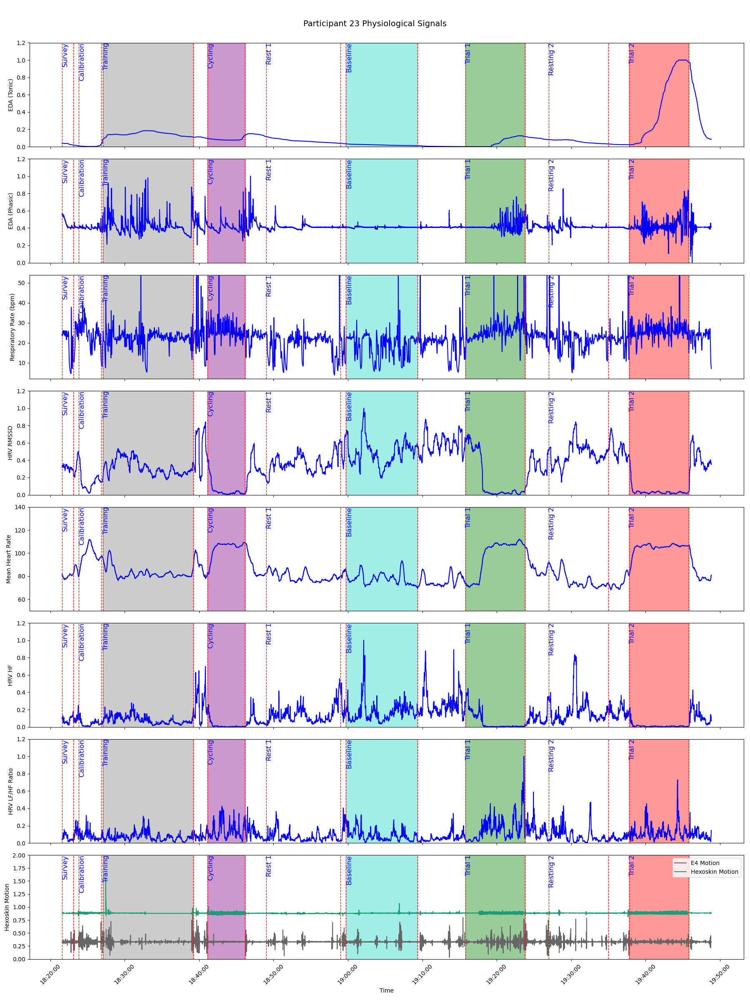

In [158]:
import matplotlib as mpl
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import neurokit2 as nk
import pandas as pd

import matplotlib.dates as mdates

signals.dropna(inplace=True)

signals['EDA_Phasic'] = nk.standardize(signals['EDA_Phasic'], robust=True)
signals['EDA_Tonic'] = nk.standardize(signals['EDA_Tonic'], robust=True)
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

scaled_columns = scaler.fit_transform(signals[['EDA_Tonic', 'EDA_Phasic', 'hrv_lf_hf_ratio', 'hrv_hf', 'hrv_rmssd']])

scaled_df = pd.DataFrame(scaled_columns, columns=['EDA_Tonic', 'EDA_Phasic', 'hrv_lf_hf_ratio', 'hrv_hf', 'hrv_rmssd'], index=signals.index)

signals[['EDA_Tonic', 'EDA_Phasic', 'hrv_lf_hf_ratio', 'hrv_hf', 'hrv_rmssd']] = scaled_df


colors = mpl.colormaps['Dark2'].colors
signal_list = [
    'hrv_hf', 'hrv_mean_hr', 'hrv_lf_hf_ratio',
    'hrv_rmssd', 'Motion E4', 'Hexoskin Motion',
    'RSP_Rate', 'EDA_Tonic', 'EDA_Phasic'
]
signals_to_plot = [sig for sig in signals.columns if sig in signal_list]
motion_signals = ["Motion E4", "Hexoskin Motion"]

num_rows = len(signals_to_plot) - len(motion_signals) + 1
fig, axes = plt.subplots(num_rows, 1, figsize=(18, 3 * num_rows), sharex=True)
axes = axes.flatten() if num_rows > 1 else [axes]

row_idx = 0
motion_trace_added = False

signal_labels = {
    'hrv_hf': 'HRV HF',
    'hrv_mean_hr': 'Mean Heart Rate',
    'hrv_lf_hf_ratio': 'HRV LF/HF Ratio',
    'hrv_rmssd': 'HRV RMSSD',
    'Motion E4': 'E4 Motion',
    'Hexoskin Motion': 'Hexoskin Motion',
    'RSP_Rate': 'Respiratory Rate (bpm)',
    'EDA_Tonic': 'EDA (Tonic)',
    'EDA_Phasic': 'EDA (Phasic)'
}

event_highlights = {
    "survey":      ("white", 0.0),
    "cycle_cal":   ("grey", 0.0),
    "matb_train":  ("grey", 0.4),
    "cycle":       ("purple", 0.4),
    "rest_1":      ("white", 0.0),
    "baseline":    ("turquoise", 0.5),
    "trial_1":     ("green", 0.4),
    "rest_2":      ("white", 0.0),
    "trial_2":     ("red", 0.4),
    "recovery":    ("white", 0.0),
}

y_limits = {
    'hrv_hf': (0, 1.2),
    'hrv_mean_hr': (50, 140),
    'hrv_lf_hf_ratio': (0, 1.2),
    'hrv_rmssd': (0, 1.2),
    'Motion E4': (0, 2),
    'Hexoskin Motion': (0, 2),
    'RSP_Rate': (2, 54),
    'EDA_Tonic': (0, 1.2),
    'EDA_Phasic': (0, 1.2)
}

event_labels = {
    "survey":      "Survey",
    "cycle_cal":   "Calibration",
    "matb_train":  "Training",
    "cycle":       "Cycling",
    "rest_1":      "Rest 1",
    "baseline":    "Baseline",
    "trial_1":     "Trial 1",
    "rest_2":      "Resting 2",
    "trial_2":     "Trial 2",
    "recovery":    "Recovery"
}


motion_offset = 0.7
for idx, signal in enumerate(signals_to_plot):
    color = colors[idx % len(colors)]
    ax = axes[row_idx]
    label = signal_labels.get(signal, signal)

    if signal in motion_signals:
        if not motion_trace_added:
            ax.plot(signals.index, signals[signal], label=label, color=color)
            motion_trace_added = True
        else:
            ax.plot(signals.index, signals[signal] + motion_offset, label=f"{label}", color=color)
    else:
        ax.plot(signals.index, signals[signal], label=label, color='b')

    ax.set_ylabel(label)
    if signal in motion_signals:
        ax.legend(loc="upper right")

    if signal in y_limits:
        ax.set_ylim(y_limits[signal])

    row_idx += (1 if not (signal in motion_signals and motion_trace_added) else 0)

for ax in axes:
    for event_label, (color, alpha) in event_highlights.items():
        event_times = signals[signals["event"] == event_label].index
        if not event_times.empty:
            ax.axvspan(event_times[0], event_times[-1], color=color, alpha=alpha)

            ax.axvline(event_times[0], color="red", linestyle="--", linewidth=1)
            ax.axvline(event_times[-1], color="red", linestyle="--", linewidth=1)

            verbose_label = event_labels.get(event_label, event_label)
            ax.text(event_times[0], ax.get_ylim()[1], verbose_label, rotation=90,
                    verticalalignment="top", color="b", fontsize=12)



for ax in axes:
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=45)

axes[-1].set_xlabel("Time")
fig.suptitle(f"Participant {participant_id} Physiological Signals", fontsize=14)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.savefig(os.path.join(dataDirectory, "labeled_data.png"))
plt.show()

In [159]:


output_dir = '/home/art/SignalProcessing/Sessions/Summary'
os.makedirs(output_dir, exist_ok=True)

summary_stats = {'participant_id': participant_id}

all_stats = signals.describe().T[['mean']]  # only mean -AJS
for signal in all_stats.index:
    summary_stats[f'all_{signal}_mean'] = all_stats.loc[signal, 'mean']

for event in signals['event'].unique():
    df_event = signals[signals['event'] == event]
    event_stats = df_event.describe().T[['mean']] # only mean -AJS
    for signal in event_stats.index:
        summary_stats[f'{event}_{signal}_mean'] = event_stats.loc[signal, 'mean']

summary_stats_df = pd.DataFrame([summary_stats])


output_file = os.path.join(output_dir, 'summary_statistics_comparison.csv')

if os.path.exists(output_file):

    existing_data = pd.read_csv(output_file)
    combined_data = pd.concat([existing_data, summary_stats_df], ignore_index=True)
    combined_data.to_csv(output_file, index=False)
else:
    summary_stats_df.to_csv(output_file, index=False)

print(f"Summary statistics for Participant {participant_id} saved to {output_file}")

Summary statistics for Participant 23 saved to /home/art/SignalProcessing/Sessions/Summary/summary_statistics_comparison.csv
